In [2]:
# Установка библиотек
!pip install folium matplotlib mapclassify pandera blocksnet ipykernel -q
!pip install folium -q

# Импорт библиотек
import osmnx as ox
import os
import json
import yaml
import pandas as pd
import geopandas as gpd
import warnings
import matplotlib.pyplot as plt
import momepy
import folium

from shapely.geometry import Point
from tqdm.auto import tqdm

# Импорт утилит из IduEdu и BlocksNet
from blocksnet import LandUsePrediction, Provision
from blocksnet.models.service_type import ServiceBrick
from blocksnet import ServiceType
from blocksnet import LandUsePrediction
from blocksnet.models.service_type import ServiceBrick
from blocksnet import Provision, ProvisionMethod


[notice] A new release of pip is available: 23.2.1 -> 25.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 25.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


1. Директории

In [3]:
# === Пути ===
DOG_INPUT = r'C:\Users\kvary\PycharmProjects\R&D_IDU\PRO_Dog\DOG_INPUT'
DOG_OUTPUT = r'C:\Users\kvary\PycharmProjects\R&D_IDU\PRO_Dog\DOG_OUTPUT'

2. Генерация кварталов

3.1 Выгрузка границ из OSM

<Axes: >

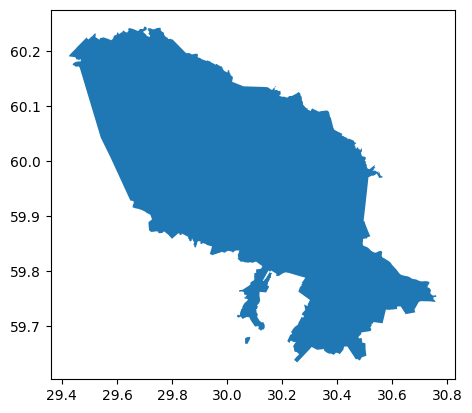

In [4]:
boundary = ox.geocode_to_gdf('Санкт-Петербург')
boundary.plot()

3.2 Квартальная нарезка

In [5]:
from dog_configs.tags import tags

water = ox.features_from_polygon(boundary.unary_union, tags['water'])
roads = ox.features_from_polygon(boundary.unary_union, tags['roads'])
railways = ox.features_from_polygon(boundary.unary_union, tags['railways'])

local_crs = boundary.estimate_utm_crs()

boundary = boundary.reset_index()[['geometry']].to_crs(local_crs)
water = water.reset_index()[['geometry']].to_crs(local_crs)
roads = roads.reset_index()[['geometry']].to_crs(local_crs)
railways = railways.reset_index()[['geometry']].to_crs(local_crs)

roads = roads[roads.geom_type.isin(['LineString', 'MultiLineString'])]

In [6]:
from blocksnet import BlocksGenerator, BlocksSplitter

# === Генерация и разрезание кварталов ===
bg = BlocksGenerator(boundary, roads, railways, water)
blocks = bg.run()

# === Сохранение ===
blocks.to_file(os.path.join(DOG_OUTPUT, "blocks.geojson"))

# === Визуализация ===

blocks_wgs = blocks.to_crs(epsg=4326)
centroid_proj = boundary.unary_union.centroid
centroid_wgs = gpd.GeoSeries([centroid_proj], crs=boundary.crs).to_crs(epsg=4326).geometry.iloc[0]
center = (centroid_wgs.y, centroid_wgs.x)

m = folium.Map(zoom_start=13, tiles="cartodbpositron")

geojson = folium.GeoJson(
    blocks_wgs,
    name="Кварталы",
    style_function=lambda x: {'color': 'forestgreen', 'weight': 1, 'fillColor': 'honeydew', 'fillOpacity': 0.3}
).add_to(m)

bounds = blocks_wgs.total_bounds  # [minx, miny, maxx, maxy]
m.fit_bounds([[bounds[1], bounds[0]], [bounds[3], bounds[2]]])

folium.LayerControl().add_to(m)
m

2025-04-24 02:03:09.718 | INFO     | blocksnet.preprocessing.blocks_generator:__init__:99 - Check boundaries schema
2025-04-24 02:03:09.756 | INFO     | blocksnet.preprocessing.blocks_generator:__init__:103 - Check roads schema
2025-04-24 02:03:09.774 | INFO     | blocksnet.preprocessing.blocks_generator:__init__:109 - Check railways schema
2025-04-24 02:03:09.781 | INFO     | blocksnet.preprocessing.blocks_generator:__init__:115 - Check water schema
2025-04-24 02:03:09.790 | INFO     | blocksnet.preprocessing.blocks_generator:__init__:124 - Exclude water objects
2025-04-24 02:03:12.047 | INFO     | blocksnet.preprocessing.blocks_generator:run:161 - Generating blocks
2025-04-24 02:03:12.128 | INFO     | blocksnet.preprocessing.blocks_generator:run:170 - Setting up enclosures
2025-04-24 02:03:17.369 | INFO     | blocksnet.preprocessing.blocks_generator:run:174 - Filling holes
2025-04-24 02:03:17.981 | INFO     | blocksnet.preprocessing.blocks_generator:run:178 - Dropping overlapping blo

4. Генерация дорожного графа и вычисление матрицы доступности

In [7]:
!pip install IduEdu

from iduedu import config
config.change_logger_lvl('DEBUG')


[notice] A new release of pip is available: 23.2.1 -> 25.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip
C:\Users\kvary\PycharmProjects\R&D_IDU\PRO_Dog\.venv\Lib\site-packages\IPython\utils\_process_win32.py:138: ResourceWarning: unclosed file <_io.BufferedWriter name=4>
  res = process_handler(cmd, _system_body)
C:\Users\kvary\PycharmProjects\R&D_IDU\PRO_Dog\.venv\Lib\site-packages\IPython\utils\_process_win32.py:138: ResourceWarning: unclosed file <_io.BufferedReader name=5>
  res = process_handler(cmd, _system_body)
C:\Users\kvary\PycharmProjects\R&D_IDU\PRO_Dog\.venv\Lib\site-packages\IPython\utils\_process_win32.py:138: ResourceWarning: unclosed file <_io.BufferedReader name=6>
  res = process_handler(cmd, _system_body)


In [8]:
from iduedu import get_boundary
from iduedu import get_walk_graph

bounds = get_boundary(osm_id=337422) # ID г. Санкт-Петербург

G_walk = get_walk_graph(polygon=bounds)

G_walk

2025-04-24 02:06:22.376 | DEBUG    | iduedu.modules.downloaders:get_boundary_by_osm_id:33 - Downloading territory bounds with osm_id <337422> ...
2025-04-24 02:06:22.884 | DEBUG    | iduedu.modules.drive_walk_builder:get_walk_graph:214 - Downloading walk graph from OSM ...
2025-04-24 02:08:59.374 | DEBUG    | iduedu.utils.utils:estimate_crs_for_bounds:35 - Estimated CRS for territory EPSG:32636


Calculating the weights of the walk graph:   0%|          | 0/1188940 [00:00<?, ?it/s]

2025-04-24 02:10:30.531 | DEBUG    | iduedu.modules.drive_walk_builder:get_walk_graph:247 - Done!


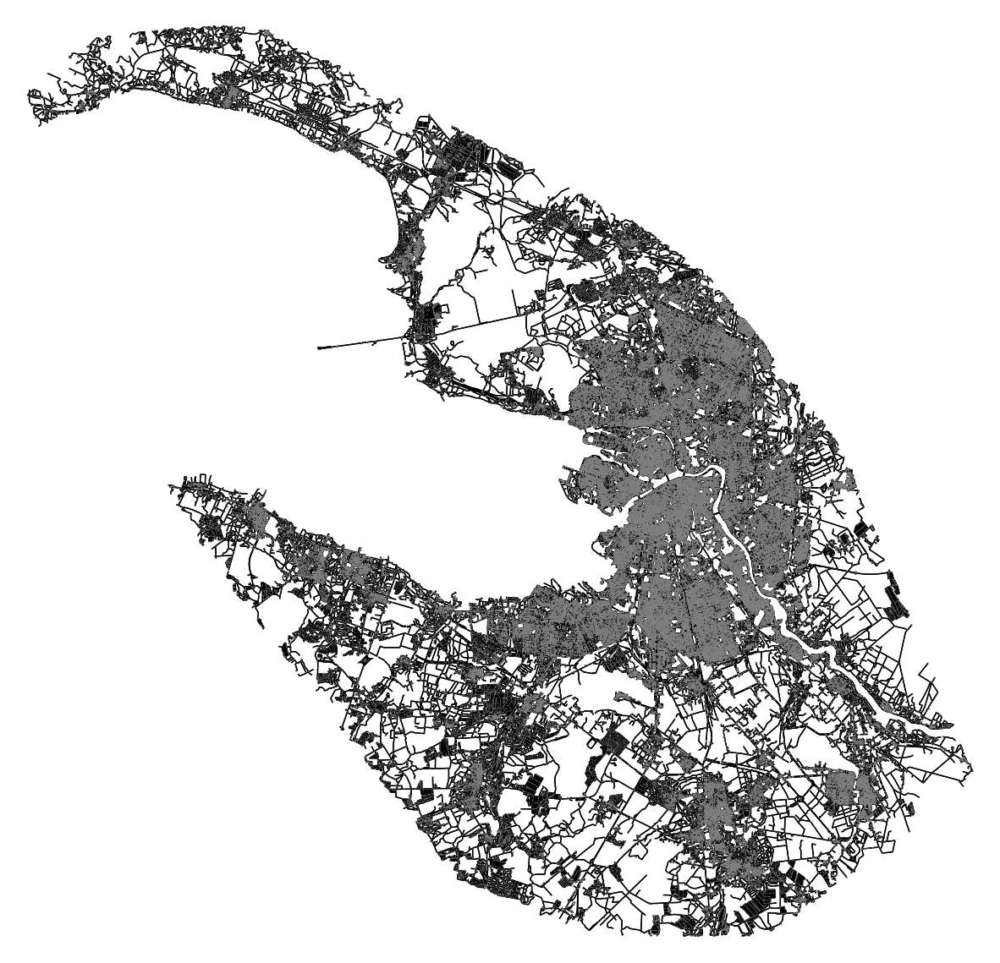

In [9]:
from blocksnet import AccessibilityProcessor

AccessibilityProcessor._fix_graph(G_walk)

fig, ax = ox.plot_graph(G_walk,
                    node_color='grey', # цвет вершин
                    edge_color='black', # цвет ребер
                    bgcolor='white', # цвет подложки
                    node_size=0.5, # размер верщин
                    edge_linewidth=1, # толщина ребер
                    figsize=(15,15)) # размер картинки

In [10]:
n,e = ox.graph_to_gdfs(G_walk)

n.to_file(os.path.join(DOG_OUTPUT, "G_drive_nodes.geojson"))
e.to_file(os.path.join(DOG_OUTPUT, "G_drive_edges.geojson"))

In [11]:
from blocksnet import AccessibilityProcessor

ap = AccessibilityProcessor(blocks)

acc_mx = ap.get_accessibility_matrix(G_walk)

acc_mx.to_pickle(os.path.join(DOG_OUTPUT, "acc_mx.pickle"))

In [12]:
from blocksnet.models import City

blocks['land_use'] = None

doggy_stpetersburg = City(
    blocks=blocks,
    acc_mx=acc_mx
)

print(doggy_stpetersburg)

doggy_stpetersburg.to_pickle(os.path.join(DOG_OUTPUT, 'stpetersburg_city_model.pickle'))

CRS : EPSG:32636
Blocks : 16107
Service types : 0/66
Buildings : 0
Services : 0



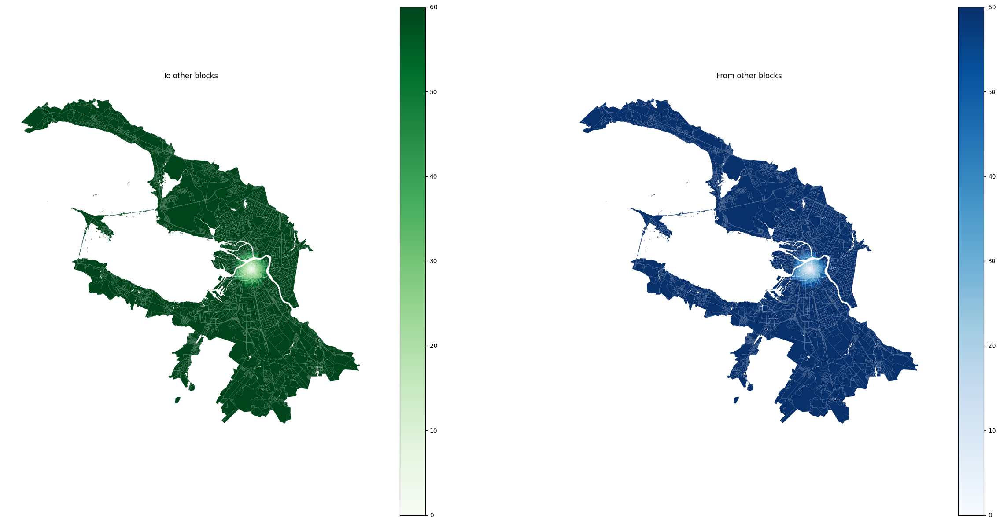

In [13]:
from blocksnet import Accessibility, Connectivity

# Accessibility

accessibility = Accessibility(city_model=doggy_stpetersburg)
block = doggy_stpetersburg[60] 
result = accessibility.calculate(block)

Accessibility.plot(result, linewidth=0.9, figsize=(30,15))

result.to_file(os.path.join(DOG_OUTPUT, 'accessibility.geojson'))

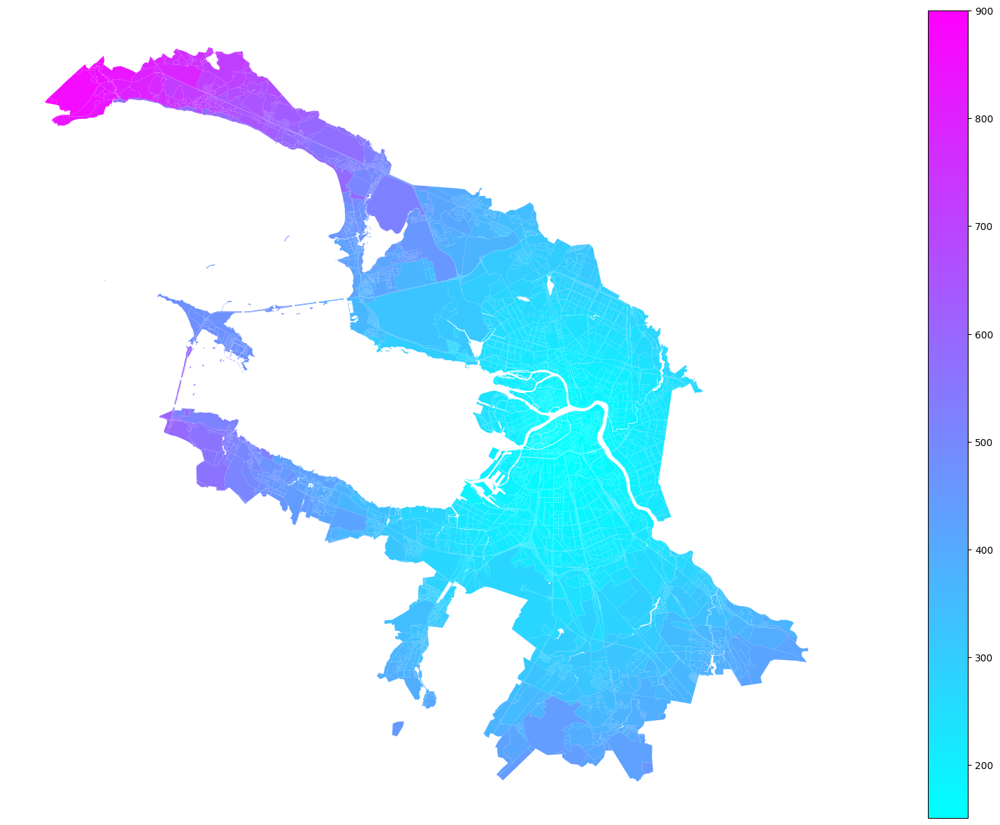

In [14]:
# Connectivity

connectivity = Connectivity(city_model=doggy_stpetersburg)
connectivity_result = connectivity.calculate()

Connectivity.plot(connectivity_result, linewidth=0.9, figsize=(30,15))

result.to_file(os.path.join(DOG_OUTPUT, 'connectivity.geojson'))

5. Обработка слоя со зданиями

In [15]:
buildings = os.path.join(DOG_INPUT, "building.geojson")

with open(buildings, 'r', encoding='utf-8') as f:
    data = json.load(f)

features = data.get('features', [])
rows = [feature.get('properties', {}) for feature in features]
df = pd.DataFrame(rows)

df.head(20) 


,address,geometry,building_area,living_area,population_balanced,is_living,building:levels,population,building
0,"Санкт-Петербург, Лахта Центр",NaN,31.743645,0.0,0,False,1.0,0,NaN
1,None,NaN,48.748478,0.0,0,False,1.0,0,NaN
2,"проспект Стачек, 98",NaN,143.723831,0.0,0,False,1.0,0,NaN
3,None,NaN,82.676750,0.0,0,False,1.0,0,NaN
4,"Санкт-Петербург, территория Автово",NaN,51.938232,0.0,0,False,1.0,0,NaN
5,None,NaN,45.132584,0.0,0,False,1.0,0,NaN
6,None,NaN,179.364441,0.0,0,False,1.0,0,NaN
7,"Санкт-Петербург, улица Возрождения",NaN,30.049412,0.0,0,False,1.0,0,NaN
8,"Санкт-Петербург, проспект Стачек, 72",NaN,125.157516,0.0,0,False,1.0,0,NaN
9,"Санкт-Петербург, территория Элеваторная Площадка",NaN,412.449036,0.0,0,False,1.0,0,NaN


In [16]:
buildings = os.path.join(DOG_INPUT, "building.geojson")
doggy_buildings = os.path.join(DOG_INPUT,  "doggy_buildings.geojson")

with open(buildings, 'r', encoding='utf-8') as f:
    geojson_data = json.load(f)

for feature in geojson_data['features']:
    if 'geometry' in feature['properties']:
        del feature['properties']['geometry']

with open(doggy_buildings, 'w', encoding='utf-8') as f:
    json.dump(geojson_data, f)

buildings = gpd.read_file(doggy_buildings)
buildings.head()

,address,building_area,living_area,population_balanced,is_living,building:levels,building,population,geometry
0,"Санкт-Петербург, Лахта Центр",31.743645,0.0,0,False,1.0,None,0,"POLYGON ((30.25811 59.86425, 30.25811 59.86428..."
1,None,48.748478,0.0,0,False,1.0,None,0,"POLYGON ((30.25851 59.86419, 30.25851 59.86424..."
2,"проспект Стачек, 98",143.723831,0.0,0,False,1.0,None,0,"POLYGON ((30.26219 59.86342, 30.26234 59.86354..."
3,None,82.676750,0.0,0,False,1.0,None,0,"POLYGON ((30.26203 59.86327, 30.26215 59.86336..."
4,"Санкт-Петербург, территория Автово",51.938232,0.0,0,False,1.0,None,0,"POLYGON ((30.28085 59.87224, 30.28091 59.87225..."


In [17]:
# Приведение к UTM
crs = boundary.estimate_utm_crs()
buildings = buildings.to_crs(crs) 

buildings['number_of_floors'] = buildings['building:levels']
buildings['non_living_area'] = buildings['building_area'] - buildings['living_area']
buildings['non_living_area'] = buildings['non_living_area'].apply(lambda x: max(x, 0))
buildings['number_of_floors'] = buildings['number_of_floors'].fillna(1)

In [18]:
doggy_stpetersburg.update_buildings(buildings)

print(doggy_stpetersburg)

2025-04-24 02:42:26.134 | INFO     | blocksnet.models.city:update_buildings:1237 - Removing existing blocks from the model
2025-04-24 02:42:26.143 | INFO     | blocksnet.models.city:update_buildings:1241 - Joining buildings and blocks
2025-04-24 02:42:44.631 | WARNING  | blocksnet.models.city:update_buildings:1253 - 39 buildings did not intersect any block
Update blocks buildings: 100%|██████████| 5448/5448 [00:40<00:00, 133.14it/s]


CRS : EPSG:32636
Blocks : 16107
Service types : 0/66
Buildings : 170391
Services : 0



6. Добавление в модель сервисов, расчёт обеспеченности

In [20]:
from dog_configs.dog_services import dog_services

def expand_services(services: list[dict]) -> list[dict]:
    expanded = []
    for s in services:
        access_list = s["accessibility"]

        if isinstance(access_list, int):
            access_list = [access_list]

        for acc in access_list:
            expanded.append({
                "code": f"{s['code']}_{acc}",  # уникальный код по времени
                "name": f"{s['name']}_{acc}",  # уникальное имя по времени доступности
                "demand": s["demand"],
                "accessibility": acc,
                "land_use": s["land_use"],
                "bricks": s["bricks"]
            })
    return expanded


expanded_services = expand_services(dog_services)

existing_service_codes = set(service.code for service in doggy_stpetersburg.service_types)

added_services = []

for s in expanded_services:
    if s["code"] not in existing_service_codes:
        service = ServiceType(
            code=s["code"],
            name=s["name"],  
            demand=s["demand"],
            accessibility=s["accessibility"],
            land_use=s["land_use"],
            bricks=s["bricks"],
        )
        doggy_stpetersburg.add_service_type(service)
        added_services.append(s["code"])
    else:
        print(f"⚠️ Сервис с кодом {s['code']} уже существует, пропускаем.")

if added_services:
    print("✅ Добавлены сервисы в модель doggy_stpetersburg:")
    for code in added_services:
        print(f"  - {code}")
else:
    print("ℹ️ Новых сервисов не добавлено — всё уже есть.")

✅ Добавлены сервисы в модель doggy_stpetersburg:
  - DOG_01_30
  - DOG_01_45
  - DOG_02_45
  - DOG_03_15
  - DOG_03_30
  - DOG_03_45
  - DOG_04_30
  - DOG_04_45
  - DOG_05_15
  - DOG_05_30
  - DOG_05_45
  - DOG_06_30
  - DOG_06_45


In [21]:
directory = r'C:\Users\kvary\PycharmProjects\R&D_IDU\PRO_Dog\DOG_INPUT\service_files'
local_crs = "EPSG:32636"

def remove_inner_polygons(gdf):
    return gdf

def remove_close_centroids(gdf):
    return gdf

for file in os.listdir(directory):
    filename = os.fsdecode(file)

    if filename.endswith(".geojson"):
        service_name = filename.removesuffix(".geojson")
        print(f"Добавляем сервис {service_name}")

        try:
            service_gdf = gpd.read_file(os.path.join(directory, filename))
            service_gdf.to_crs(local_crs, inplace=True)

            service = remove_inner_polygons(service_gdf)
            service['geometry'] = service.centroid
            service = remove_close_centroids(service)

            service = service[["geometry"]]

            doggy_stpetersburg.update_services(service_name, service)

            print(f"✅ Геометрия для сервиса '{service_name}' обновлена.")

        except Exception as e:
            print(f"Ошибка при обработке сервиса {service_name}: {e}")
    else:
        continue

Добавляем сервис dog_train_park_45
✅ Геометрия для сервиса 'dog_train_park_45' обновлена.
Добавляем сервис dog_walk_park_30
✅ Геометрия для сервиса 'dog_walk_park_30' обновлена.
Добавляем сервис dog_walk_park_45
✅ Геометрия для сервиса 'dog_walk_park_45' обновлена.
Добавляем сервис large_park_30
✅ Геометрия для сервиса 'large_park_30' обновлена.
Добавляем сервис large_park_45
✅ Геометрия для сервиса 'large_park_45' обновлена.
Добавляем сервис petshop_15
✅ Геометрия для сервиса 'petshop_15' обновлена.
Добавляем сервис petshop_30
✅ Геометрия для сервиса 'petshop_30' обновлена.
Добавляем сервис petshop_45
✅ Геометрия для сервиса 'petshop_45' обновлена.
Добавляем сервис small_park_15
✅ Геометрия для сервиса 'small_park_15' обновлена.
Добавляем сервис small_park_30
✅ Геометрия для сервиса 'small_park_30' обновлена.
Добавляем сервис small_park_45
✅ Геометрия для сервиса 'small_park_45' обновлена.
Добавляем сервис veterinary_30
✅ Геометрия для сервиса 'veterinary_30' обновлена.
Добавляем серв

In [22]:
from blocksnet import LandUsePrediction 

lup = LandUsePrediction(city_model=doggy_stpetersburg)
lu_blocks = lup.calculate()
lu_blocks.head()

doggy_stpetersburg.update_land_use(lu_blocks)

100%|██████████| 16107/16107 [01:02<00:00, 258.19it/s]


In [23]:
import os
import folium
import matplotlib.pyplot as plt

# Список сервисов с уровнями доступности 15, 30 и 45 минут
service_types = [
    'dog_walk_park_30', 'dog_walk_park_45',
    'dog_train_park_45', 'large_park_30', 'large_park_45',
    'petshop_15', 'petshop_30', 'petshop_45', 'veterinary_30', 'veterinary_45',
    'small_park_15', 'small_park_30', 'small_park_45'
]

# Путь к папке, где сохраняем результаты
services_result = r'C:\Users\kvary\PycharmProjects\R&D_IDU\PRO_Dog\DOG_OUTPUT\result'
os.makedirs(services_result, exist_ok=True)

# Преобразуем геометрию границ в координаты для центра карты
city_center = boundary.geometry.unary_union.centroid
lat, lon = city_center.y, city_center.x

# Перебираем типы сервисов
for dog_services in service_types:
    print(f"Расчёт обеспеченности для сервиса: {dog_services}")

    # Расчёт обеспеченности
    prov = Provision(city_model=doggy_stpetersburg)
    prov_res = prov.calculate(dog_services)

    # Построение и сохранение графика
    prov.plot(prov_res)
    plot_file_name = f"{dog_services}.png"
    plt.savefig(os.path.join(services_result, plot_file_name))
    plt.close()

    # Сохранение в GeoJSON
    geojson_file_name = f"{dog_services}.geojson"
    prov_res.to_file(os.path.join(services_result, geojson_file_name), driver="GeoJSON")

# Сохранение модели города, если нужно
doggy_stpetersburg.to_pickle(os.path.join(DOG_OUTPUT, "stpetersburg_city_model (+ services).pickle")
)


Расчёт обеспеченности для сервиса: dog_walk_park_30


2025-04-24 02:49:58.640 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 30 : 3081x65
2025-04-24 02:50:00.053 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:50:00.335 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:50:00.384 | SUCCESS  | blocksnet.method.provision:calculate:272 - Provision assessment finished


Расчёт обеспеченности для сервиса: dog_walk_park_45


2025-04-24 02:50:32.365 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 45 : 3081x65
2025-04-24 02:50:34.265 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:50:34.472 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:50:34.546 | SUCCESS  | blocksnet.method.provision:calculate:272 - Provision assessment finished


Расчёт обеспеченности для сервиса: dog_train_park_45


2025-04-24 02:50:44.995 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 45 : 3081x6
2025-04-24 02:50:45.173 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:50:45.245 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:50:45.254 | SUCCESS  | blocksnet.method.provision:calculate:272 - Provision assessment finished


Расчёт обеспеченности для сервиса: large_park_30


2025-04-24 02:50:54.157 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 30 : 3081x50
2025-04-24 02:50:55.966 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:50:56.051 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:50:56.365 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 60 : 2124x50
2025-04-24 02:50:57.176 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:50:57.262 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:50:57.574 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 90 : 1178x50
2025-04-24 02:50:58.038 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:50:58.110 | INFO     | bl

Расчёт обеспеченности для сервиса: large_park_45


2025-04-24 02:51:07.222 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 45 : 3081x50
2025-04-24 02:51:08.369 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:51:08.488 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:51:08.945 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 90 : 1585x50
2025-04-24 02:51:09.568 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:51:09.680 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:51:09.999 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 135 : 612x50
2025-04-24 02:51:10.219 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:51:10.269 | INFO     | bl

Расчёт обеспеченности для сервиса: petshop_15


2025-04-24 02:51:20.483 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 15 : 3081x685
2025-04-24 02:51:36.145 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:51:36.474 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:51:36.802 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 30 : 2805x22
2025-04-24 02:51:37.230 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:51:37.295 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:51:37.310 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 45 : 2800x3
2025-04-24 02:51:37.394 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:51:37.449 | INFO     | bl

Расчёт обеспеченности для сервиса: petshop_30


2025-04-24 02:51:47.063 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 30 : 3081x685
2025-04-24 02:52:02.550 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:52:03.515 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:52:04.025 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 60 : 2820x3
2025-04-24 02:52:04.108 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:52:04.172 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:52:04.187 | SUCCESS  | blocksnet.method.provision:calculate:272 - Provision assessment finished


Расчёт обеспеченности для сервиса: petshop_45


2025-04-24 02:52:13.481 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 45 : 3081x685
2025-04-24 02:52:29.068 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:52:30.900 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:52:31.654 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 90 : 2824x1
2025-04-24 02:52:31.703 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:52:31.760 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:52:31.784 | SUCCESS  | blocksnet.method.provision:calculate:272 - Provision assessment finished


Расчёт обеспеченности для сервиса: veterinary_30


2025-04-24 02:52:40.522 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 30 : 3081x310
2025-04-24 02:52:47.237 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:52:47.627 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:52:47.835 | SUCCESS  | blocksnet.method.provision:calculate:272 - Provision assessment finished


Расчёт обеспеченности для сервиса: veterinary_45


2025-04-24 02:52:56.747 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 45 : 3081x310
2025-04-24 02:53:03.417 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:53:04.136 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:53:04.436 | SUCCESS  | blocksnet.method.provision:calculate:272 - Provision assessment finished


Расчёт обеспеченности для сервиса: small_park_15


2025-04-24 02:53:13.455 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 15 : 3081x2698
2025-04-24 02:54:14.031 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:54:14.943 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:54:15.990 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 30 : 1017x2698
2025-04-24 02:54:35.534 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:54:35.606 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:54:35.692 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 45 : 748x2698
2025-04-24 02:54:48.968 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:54:49.045 | INFO    

Расчёт обеспеченности для сервиса: small_park_30


2025-04-24 02:54:58.425 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 30 : 3081x2698
2025-04-24 02:55:56.834 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:55:59.947 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:56:01.704 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 60 : 748x2698
2025-04-24 02:56:14.912 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:56:14.989 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:56:15.050 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 90 : 562x2698
2025-04-24 02:56:24.831 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:56:24.928 | INFO     

Расчёт обеспеченности для сервиса: small_park_45


2025-04-24 02:56:33.322 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 45 : 3081x2698
2025-04-24 02:57:56.863 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:58:04.516 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:58:07.600 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 90 : 611x2698
2025-04-24 02:58:18.655 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:58:18.743 | INFO     | blocksnet.method.provision:_lp_provision:359 - Restoring values from variables
2025-04-24 02:58:18.812 | INFO     | blocksnet.method.provision:_lp_provision:321 - Setting an LP problem for accessibility = 135 : 412x2698
2025-04-24 02:58:26.217 | INFO     | blocksnet.method.provision:_lp_provision:355 - Solving the problem
2025-04-24 02:58:26.308 | INFO    

In [29]:
import pandas as pd
from dog_configs.load_services import load_services_data
from dog_configs.scenario_weights import UNIVERSAL_WEIGHTS, SCENARIOS

city_blocks_gdf = load_services_data()

records = []
weighted_totals = []

for scenario_name, data in SCENARIOS.items():
    threshold = data["threshold"]
    services = data["services"]

    record = {"Сценарий": scenario_name}
    weighted_sum = 0
    total_weight = 0

    for service in services:
        col = f"{service}_{threshold}_provision"
        if col in city_blocks_gdf.columns:
            value = city_blocks_gdf[col].mean()
            if pd.notna(value):
                weight = UNIVERSAL_WEIGHTS.get(service, 0)
                weighted_sum += value * weight
                total_weight += weight
                record[service] = round(value, 3)
            else:
                record[service] = None
        else:
            record[service] = None

    avg_weighted = weighted_sum / total_weight if total_weight > 0 else None
    record["Итог по сценарию"] = round(avg_weighted, 3) if avg_weighted is not None else None
    if avg_weighted is not None:
        weighted_totals.append(avg_weighted)
    records.append(record)

# Финальный DataFrame
df = pd.DataFrame(records)
df = df.set_index("Сценарий")

# Переименование столбцов
df = df.rename(columns={
    "small_park": "Малый парк",
    "large_park": "Большой парк",
    "dog_walk_park": "Площадка для выгула",
    "dog_train_park": "Площадка для дрессировки",
    "veterinary": "Ветеринарная клиника",
    "petshop": "Зоомагазин",
})

# Упорядочивание столбцов
ordered_cols = [
    "Малый парк", "Большой парк", "Площадка для выгула",
    "Площадка для дрессировки", "Ветеринарная клиника", "Зоомагазин",
    "Итог по сценарию"
]
df = df.reindex(columns=[col for col in ordered_cols if col in df.columns])

# Отображение таблицы
from IPython.display import display
display(df.style.set_caption("Обеспеченность по сценариям")
             .format(precision=3)
             .set_table_styles([{
                 'selector': 'caption',
                 'props': [('caption-side', 'top'),
                           ('font-size', '16px'),
                           ('font-weight', 'bold')]
             }])
             .background_gradient(subset=["Итог по сценарию"], cmap="YlGn")
       )

# Финальный интегральный показатель
if weighted_totals:
    final_index = sum(weighted_totals) / len(weighted_totals)
    print(f"\n🎯 Итоговый интегральный показатель обеспеченности: {final_index:.3f}")
else:
    print("\n⚠️ Не удалось рассчитать итоговый показатель: отсутствуют данные.")



⚠️ Файл не найден: dog_walk_park_15.geojson
⚠️ Файл не найден: dog_train_park_15.geojson
⚠️ Файл не найден: dog_train_park_30.geojson
⚠️ Файл не найден: large_park_15.geojson
⚠️ Файл не найден: veterinary_15.geojson


,Малый парк,Большой парк,Площадка для выгула,Площадка для дрессировки,Ветеринарная клиника,Зоомагазин,Итог по сценарию
Сценарий,,,,,,,
Сценарий 1,0.670,nan,nan,nan,nan,0.152,0.359
Сценарий 2,0.757,0.311,0.009,nan,0.055,nan,0.181
Сценарий 3,0.802,0.486,0.009,0.000,0.053,0.146,0.161



🎯 Итоговый интегральный показатель обеспеченности: 0.234


In [34]:
import pandas as pd
from dog_configs.load_services import load_services_data
from dog_configs.scenario_weights import UNIVERSAL_WEIGHTS, SCENARIOS

# Загрузка данных
city_blocks_gdf = load_services_data()

records = []
weighted_totals = []

# Перебор всех сценариев
for scenario_name, data in SCENARIOS.items():
    threshold = data["threshold"]
    services = data["services"]

    record = {"Сценарий": scenario_name}
    weighted_sum = 0
    total_weight = 0

    # Перебор всех сервисов в сценарии
    for service in services:
        col = f"{service}_{threshold}_provision"
        if col in city_blocks_gdf.columns:
            value = city_blocks_gdf[col].mean()  # Среднее значение обеспеченности для сервиса
            print(f"Значение для {service} на пороге {threshold}: {value}")  # Логирование

            if pd.notna(value):
                weight = UNIVERSAL_WEIGHTS.get(service, 0)
                print(f"Вес для {service}: {weight}")  # Логирование
                weighted_sum += value * weight  # Умножаем на вес
                total_weight += weight  # Суммируем веса
                record[service] = round(value, 3)
            else:
                record[service] = None  # Если данных нет, оставляем None
        else:
            record[service] = None  # Если столбца нет, оставляем None

    # Расчет итогового средневзвешенного значения по сценарию
    if total_weight > 0:
        avg_weighted = weighted_sum / total_weight
        print(f"Итог по сценарию '{scenario_name}': {avg_weighted}")  # Логирование
    else:
        avg_weighted = None

    record["Итог по сценарию"] = round(avg_weighted, 3) if avg_weighted is not None else None

    # Добавляем в итоговый список
    if avg_weighted is not None:
        weighted_totals.append(avg_weighted)
    records.append(record)

# Создание финального DataFrame
df = pd.DataFrame(records)
df = df.set_index("Сценарий")

# Переименование столбцов
df = df.rename(columns={
    "small_park": "Малый парк",
    "large_park": "Большой парк",
    "dog_walk_park": "Площадка для выгула",
    "dog_train_park": "Площадка для дрессировки",
    "veterinary": "Ветеринарная клиника",
    "petshop": "Зоомагазин",
})

# Упорядочивание столбцов
ordered_cols = [
    "Малый парк", "Большой парк", "Площадка для выгула",
    "Площадка для дрессировки", "Ветеринарная клиника", "Зоомагазин",
    "Итог по сценарию"
]
df = df.reindex(columns=[col for col in ordered_cols if col in df.columns])

# Отображение таблицы
from IPython.display import display
display(df.style.set_caption("Обеспеченность по сценариям")
             .format(precision=3)
             .set_table_styles([{
                 'selector': 'caption',
                 'props': [('caption-side', 'top'),
                           ('font-size', '16px'),
                           ('font-weight', 'bold')]
             }])
             .background_gradient(subset=["Итог по сценарию"], cmap="YlGn")
       )

# Финальный интегральный показатель
if weighted_totals:
    final_index = sum(weighted_totals) / len(weighted_totals)
    print(f"\n🎯 Итоговый интегральный показатель обеспеченности: {final_index:.3f}")
else:
    print("\n⚠️ Не удалось рассчитать итоговый показатель: отсутствуют данные.")



⚠️ Файл не найден: dog_walk_park_15.geojson
⚠️ Файл не найден: dog_train_park_15.geojson
⚠️ Файл не найден: dog_train_park_30.geojson
⚠️ Файл не найден: large_park_15.geojson
⚠️ Файл не найден: veterinary_15.geojson
Значение для small_park на пороге 15: 0.6699123661148978
Вес для small_park: 1
Значение для petshop на пороге 15: 0.15216119657519336
Вес для petshop: 0.5
Итог по сценарию 'Сценарий 1': 0.49732864293499635
Значение для small_park на пороге 30: 0.7572216812723142
Вес для small_park: 1
Значение для large_park на пороге 30: 0.31061343719571566
Вес для large_park: 1
Значение для dog_walk_park на пороге 30: 0.008544414143022407
Вес для dog_walk_park: 3
Значение для veterinary на пороге 30: 0.05471859166674025
Вес для veterinary: 0.75
Итог по сценарию 'Сценарий 2': 0.1973056181995047
Значение для small_park на пороге 45: 0.8016877637130801
Вес для small_park: 1
Значение для large_park на пороге 45: 0.48555663745537164
Вес для large_park: 1
Значение для dog_walk_park на пороге 45:

,Малый парк,Большой парк,Площадка для выгула,Площадка для дрессировки,Ветеринарная клиника,Зоомагазин,Итог по сценарию
Сценарий,,,,,,,
Сценарий 1,0.670,nan,nan,nan,nan,0.152,0.497
Сценарий 2,0.757,0.311,0.009,nan,0.055,nan,0.197
Сценарий 3,0.802,0.486,0.009,0.000,0.053,0.146,0.173



🎯 Итоговый интегральный показатель обеспеченности: 0.289


C:\Users\kvary\AppData\Local\Temp\ipykernel_6116\1207667510.py:43: UserWarning: Glyph 128506 (\N{WORLD MAP}) missing from current font.
  plt.tight_layout()
C:\Users\kvary\AppData\Local\Temp\ipykernel_6116\1207667510.py:47: UserWarning: Glyph 128506 (\N{WORLD MAP}) missing from current font.
  plt.savefig(png_path, dpi=300)
C:\Users\kvary\PycharmProjects\R&D_IDU\PRO_Dog\.venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128506 (\N{WORLD MAP}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


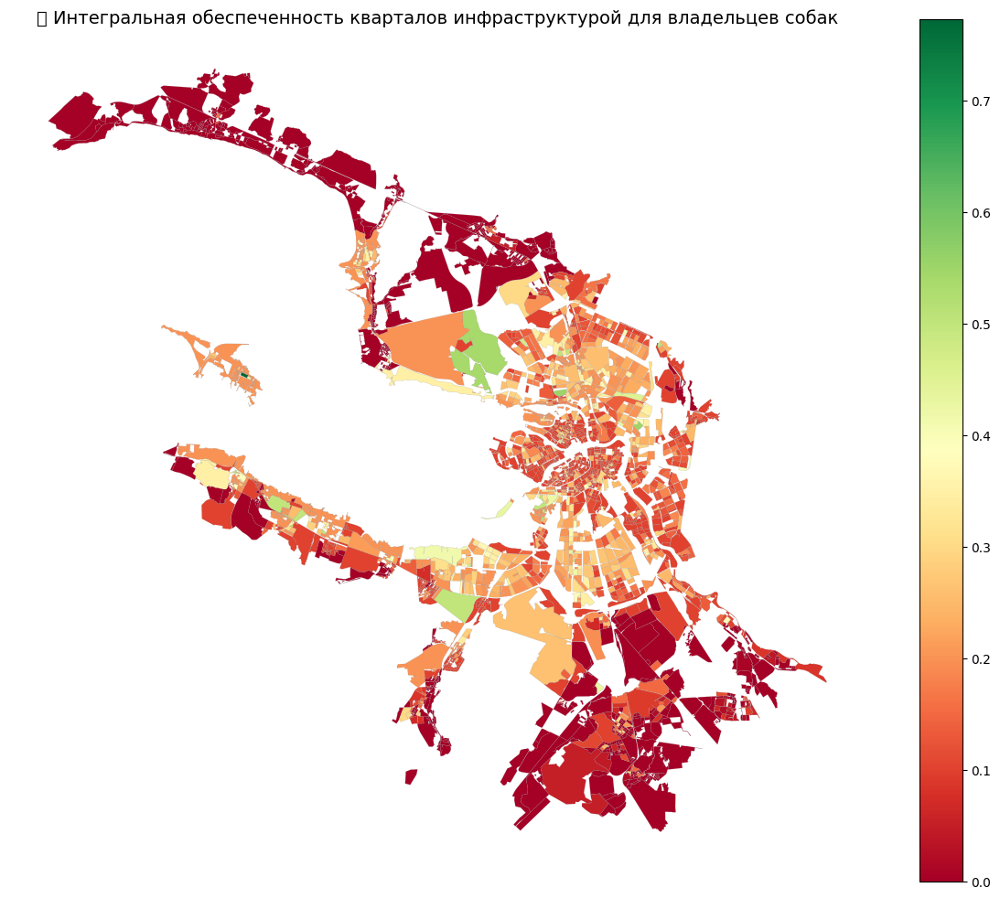

In [25]:
import geopandas as gpd
import matplotlib.pyplot as plt
import os

# Путь для сохранения результатов
output_path = "output"  # можешь заменить на свой путь
os.makedirs(output_path, exist_ok=True)

# Создаём новую колонку для итоговой обеспеченности
city_blocks_gdf["integral_provision"] = 0.0

for index, row in city_blocks_gdf.iterrows():
    total = 0
    weight_sum = 0
    for service in UNIVERSAL_WEIGHTS:
        for scenario_name, data in SCENARIOS.items():
            threshold = data["threshold"]
            if service in data["services"]:
                col_name = f"{service}_{threshold}_provision"
                if col_name in city_blocks_gdf.columns:
                    val = row[col_name]
                    if pd.notnull(val):
                        total += val * UNIVERSAL_WEIGHTS[service]
                        weight_sum += UNIVERSAL_WEIGHTS[service]
                    break
    if weight_sum > 0:
        city_blocks_gdf.at[index, "integral_provision"] = total / weight_sum
    else:
        city_blocks_gdf.at[index, "integral_provision"] = None

# Строим карту
fig, ax = plt.subplots(1, 1, figsize=(12, 10))
city_blocks_gdf.plot(
    column="integral_provision",
    cmap="RdYlGn",
    linewidth=0.1,
    edgecolor="grey",
    legend=True,
    ax=ax
)
ax.set_title("🗺️ Интегральная обеспеченность кварталов инфраструктурой для владельцев собак", fontsize=14)
ax.axis('off')
plt.tight_layout()

# Сохраняем как PNG
png_path = os.path.join(DOG_OUTPUT, "integral_provision_map.png")
plt.savefig(png_path, dpi=300)
plt.show()

# Сохраняем как GeoJSON
geojson_path = os.path.join(DOG_OUTPUT, "integral_provision.geojson")
city_blocks_gdf.to_file(geojson_path, driver="GeoJSON")


In [26]:
import folium
import branca.colormap as cm
import pandas as pd

# Убедимся, что координаты в WGS84
city_blocks_gdf = city_blocks_gdf.to_crs(epsg=4326)

# Центр карты
map_center = city_blocks_gdf.geometry.unary_union.centroid.coords[:][0][::-1]

# Базовая карта
m = folium.Map(location=map_center, zoom_start=12, tiles="cartodbpositron")

# Функция интерпретации обеспеченности
def interpret_provision(value):
    if pd.isnull(value):
        return "нет данных"
    elif value < 0.5:
        return "низкая обеспеченность"
    elif 0.5 <= value < 0.8:
        return "умеренная обеспеченность"
    elif 0.8 <= value < 0.9:
        return "приближенная к достаточной обеспеченность"
    else:
        return "высокая обеспеченность"

# Цветовая шкала (одна на все слои)
vmin = min(
    city_blocks_gdf["integral_provision"].min(),
    *(city_blocks_gdf[f"{s}_{d['threshold']}_provision"].min()
      for d in SCENARIOS.values() for s in d["services"]
      if f"{s}_{d['threshold']}_provision" in city_blocks_gdf.columns)
)
vmax = max(
    city_blocks_gdf["integral_provision"].max(),
    *(city_blocks_gdf[f"{s}_{d['threshold']}_provision"].max()
      for d in SCENARIOS.values() for s in d["services"]
      if f"{s}_{d['threshold']}_provision" in city_blocks_gdf.columns)
)
colormap = cm.LinearColormap(["red", "yellow", "green"], vmin=vmin, vmax=vmax, caption="Обеспеченность")

# Функция для добавления слоя
def add_layer(gdf, value_col, label_col, name, colormap, m):
    folium.GeoJson(
        gdf,
        name=name,
        style_function=lambda feature: {
            'fillColor': colormap(feature['properties'][value_col]) if feature['properties'][value_col] is not None else 'transparent',
            'color': 'grey',
            'weight': 0.3,
            'fillOpacity': 0.7,
        },
        tooltip=folium.GeoJsonTooltip(
            fields=[value_col, label_col],
            aliases=[f"{name}: ", "Интерпретация: "],
            localize=True
        )
    ).add_to(m)

# Добавляем слои по сценариям
for scenario_name, data in SCENARIOS.items():
    threshold = data["threshold"]
    services = data["services"]
    temp_col = f"scenario_{threshold}_avg"
    label_col = f"{temp_col}_label"
    city_blocks_gdf[temp_col] = 0.0

    for idx, row in city_blocks_gdf.iterrows():
        total = 0
        wsum = 0
        for s in services:
            col = f"{s}_{threshold}_provision"
            if col in row and pd.notnull(row[col]):
                total += row[col] * UNIVERSAL_WEIGHTS[s]
                wsum += UNIVERSAL_WEIGHTS[s]
        city_blocks_gdf.at[idx, temp_col] = total / wsum if wsum > 0 else None

    city_blocks_gdf[label_col] = city_blocks_gdf[temp_col].apply(interpret_provision)
    add_layer(city_blocks_gdf, temp_col, label_col, scenario_name, colormap, m)

# Интерпретация для интегральной обеспеченности
city_blocks_gdf["integral_label"] = city_blocks_gdf["integral_provision"].apply(interpret_provision)
add_layer(city_blocks_gdf, "integral_provision", "integral_label", "Интегральная обеспеченность", colormap, m)

# Добавляем легенду и контроль слоёв
colormap.add_to(m)
folium.LayerControl(collapsed=False).add_to(m)

# Сохраняем карту
m.save(r'C:\Users\kvary\PycharmProjects\R&D_IDU\PRO_Dog\DOG_OUTPUT\interactive_integral_provision_map_1.html')
